## Project Description
Glide Path Optimization with Reinfocement Learning

## Check Colab & TF

In [ ]:
try:
  from google.colab import drive
  IN_COLAB=True
except:
  IN_COLAB=False

if IN_COLAB:
  print("We're running Colab")

We're running Colab


In [ ]:
import tensorflow as tf

print("Running TensorFlow version ",tf.__version__)



Running TensorFlow version  2.8.0


## Import Data from yfinance

In [ ]:
!pip install yfinance
!pip install -q xlrd
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt

     |████████████████████████████████| 63 kB 2.1 MB/s 
     |████████████████████████████████| 6.4 MB 46.6 MB/s 
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
  Attempting uninstall: lxml
    Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
# S&P 500
ticker = "^GSPC"
start_date = '1969-12-31'
end_date = '2022-1-1'

sp500 = yf.download(ticker, start=start_date, end=end_date)
sp500['sp500_Return'] = sp500['Adj Close'] / sp500['Adj Close'].shift(1) - 1
sp500

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,sp500_Return
Date,,,,,,,
1969-12-31,0.000000,92.940002,91.150002,92.059998,92.059998,19380000,NaN
1970-01-02,0.000000,93.540001,91.790001,93.000000,93.000000,8050000,0.010211
1970-01-05,0.000000,94.250000,92.529999,93.459999,93.459999,11490000,0.004946
1970-01-06,0.000000,93.809998,92.129997,92.820000,92.820000,11460000,-0.006848
1970-01-07,0.000000,93.379997,91.930000,92.629997,92.629997,10010000,-0.002047
...,...,...,...,...,...,...,...
2021-12-27,4733.990234,4791.490234,4733.990234,4791.189941,4791.189941,2264120000,0.013839
2021-12-28,4795.490234,4807.020020,4780.040039,4786.350098,4786.350098,2217050000,-0.001010
2021-12-29,4788.640137,4804.060059,4778.080078,4793.060059,4793.060059,2369370000,0.001402


In [ ]:
# Bond index
ticker = "FBNDX"
start_date = '1969-12-31'
end_date = '2022-1-1'

bond = yf.download(ticker, start=start_date, end=end_date)
bond['FBNDX_Return'] = bond['Adj Close'] / bond['Adj Close'].shift(1) - 1
bond

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,FBNDX_Return
Date,,,,,,,
1980-01-02,7.38,7.38,7.38,7.38,0.494436,0,NaN
1980-01-03,7.35,7.35,7.35,7.35,0.492426,0,-0.004065
1980-01-04,7.35,7.35,7.35,7.35,0.492426,0,0.000000
1980-01-07,7.35,7.35,7.35,7.35,0.492426,0,0.000000
1980-01-08,7.36,7.36,7.36,7.36,0.493095,0,0.001359
...,...,...,...,...,...,...,...
2021-12-27,8.37,8.37,8.37,8.37,8.333302,0,0.001196
2021-12-28,8.37,8.37,8.37,8.37,8.333302,0,0.000000
2021-12-29,8.35,8.35,8.35,8.35,8.313390,0,-0.002390


In [ ]:
dfs = sp500[['sp500_Return']].dropna()
dfb = bond[['FBNDX_Return']].dropna()

df = pd.merge(dfs, dfb, how='inner', on='Date')
df

,sp500_Return,FBNDX_Return
Date,,
1980-01-03,-0.005106,-0.004065
1980-01-04,0.012355,0.000000
1980-01-07,0.002723,0.000000
1980-01-08,0.020036,0.001359
1980-01-09,0.000918,0.000000
...,...,...
2021-12-27,0.013839,0.001196
2021-12-28,-0.001010,0.000000
2021-12-29,0.001402,-0.002390


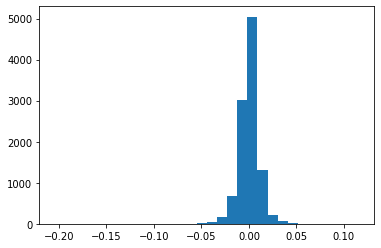

In [ ]:
### monthly equity returns ###
df.columns = ["StockRet", "BondRet"]
equity_ret = df["StockRet"]#((df['Equity']-df['Equity'].shift(-1))/df['Equity'].shift(-1))[:-1]
_ = plt.hist(equity_ret, bins=30)

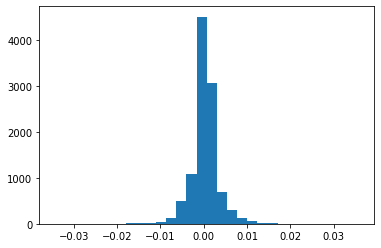

In [ ]:
### monthly bond returns ###

bond_ret = df["BondRet"]#((df['Bond']-df['Bond'].shift(-1))/df['Bond'].shift(-1)[:-1])[:-1]
_ = plt.hist(bond_ret, bins=30)

In [ ]:
# Add a year Column

import datetime as dt
def split_years(df):
    df['year'] = df['Date'].dt.year
    return [df[df['year'] == y] for y in df['year'].unique()]

In [ ]:
df['Date'] = df.index
dfSplit = split_years(df)
dfSplit[1]

,StockRet,BondRet,Date,year
Date,,,,
1981-01-02,0.004272,0.000000,1981-01-02,1981
1981-01-05,0.011955,0.011869,1981-01-05,1981
1981-01-06,0.001087,0.002932,1981-01-06,1981
1981-01-07,-0.022010,-0.008771,1981-01-07,1981
1981-01-08,-0.014954,-0.002948,1981-01-08,1981
...,...,...,...,...
1981-12-24,0.001880,0.003295,1981-12-24,1981
1981-12-28,-0.002203,0.000000,1981-12-28,1981
1981-12-29,-0.004907,-0.006569,1981-12-29,1981


## Reinforcement Learning

### RL funcitons

In [ ]:
import tensorflow as tf
import tensorflow.keras as keras
import tensorflow.keras.layers as layers
import tensorflow.keras.initializers as initializers
! pip install tensorflow-addons
import tensorflow_addons as tfa

     |████████████████████████████████| 1.1 MB 9.6 MB/s 


In [ ]:
# Needed for animation

def plot():
    # """Plot bar chart with selection probability per bandit"""
        fig = plt.figure()

        ax = fig.add_axes([0,0,1,1])
        invest = ['Stock Posotion', 'Bond Position', 'Return', 'Risk']
        actor = [action[0, 0], action[0, 1], ret, risk]
        ax.bar(invest, actor)

        # Add labels and legend
        plt.xlabel('Episode')
        plt.ylabel('Action')
        plt.legend(loc='best')
        
        plt.show()

def multiPlot(Rec):
  #actionsRec
  x = range(age, age+Duration-1)
  y1 = np.stack(Rec, axis=0)[:, 0]
  y2 = np.stack(Rec, axis=0)[:, 1]

  plt.stackplot(x, y1, y2, labels=['Stock','Bond'])
  
  plt.legend(loc='best')
  plt.show()

        
        

In [ ]:
def construct_actor_network(input_shape):
    # """Construct the actor network with mu and sigma as output"""
    inputs = layers.Input(shape=(input_shape, 3)) #input dimension
    lstm = layers.LSTM(20, dropout=0.1)(inputs)
    # hidden1 = layers.Dense(10, activation="relu",kernel_initializer=initializers.he_normal())(lstm)
    weights = layers.Dense(2, kernel_initializer=initializers.Ones(),activation="softmax")(lstm)

    actor_network = keras.Model(inputs=inputs, outputs=[weights]) 
    
    return actor_network

In [ ]:
import math

def get_reward(state, action, age):
    # calculate total return
    tfMul = tf.multiply(state[0, :, :], action)
    tfAdd = tfMul[:, 0] + tfMul[:, 1]
    add1 = tf.add(tfAdd, 1)
    tfProd = tf.math.reduce_prod(add1)
    r = tf.add(tfProd, -1)

    # calculate downside risk
    zero = tf.constant(0, dtype=tf.float32)
    where = tf.math.less(tfAdd, zero)
    negative = tfAdd[where]
    square = tf.math.square(negative)
    sum = tf.reduce_mean(square)
    dd = tf.sqrt(sum) 

    # calculate rewrad
    riskP = r - dd*alpha
    ageFact = math.sqrt(age)
    glide = beta * tf.multiply(ageFact, action[:, 0])
    reward = riskP - glide

    return reward, dd, r

### Single Epoch Policy Gradient **(DO NOT RUN THIS SECTION)**

In [ ]:
input_shape = dfSplit[0][['StockRet', 'BondRet']].shape[0]

arySplit = dfSplit[0][['StockRet', 'BondRet']].to_numpy().reshape(1, input_shape, 2)

state = tf.constant(arySplit,dtype=np.float32)

# Construct actor network
actor_network = construct_actor_network(input_shape)

# Define optimizer
opt = keras.optimizers.Adam(learning_rate=0.001)

print(actor_network.summary())

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 252, 3)]          0         
                                                                 
 lstm (LSTM)                 (None, 20)                1920      
                                                                 
 dense (Dense)               (None, 10)                210       
                                                                 
 dense_1 (Dense)             (None, 2)                 22        
                                                                 
Total params: 2,152
Trainable params: 2,152
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
age = 20
alpha = 0.1
beta = 0.0007

for i in range(50 + 1):
  with tf.GradientTape() as tape:  
        # Obtain action weights from network
        action_weights = actor_network(state)
        # print('action: ', action_weights)

        # set action
        action = action_weights
        
        # Obtain reward
        reward, risk, ret = get_reward(state, action, age)  
        # print('reward: ', reward)

        # Compute gradients
        grads = tape.gradient(-reward, actor_network.trainable_variables)
        # print(grads)

        #Apply gradients to update network weights
        opt.apply_gradients(zip(grads, actor_network.trainable_variables))

        # Animation
        if np.mod(i, 25) == 0:       
          print('\n======episode',i, '======')
          print('action', action)
          print('reward',float(reward))
          print('risk',float(risk))
          print('return',float(ret))

          plot() 


ValueError: ignored

### Multi-epoch Policy Gradient

#### make all dfs same shape

In [ ]:
minLen = len(min(dfSplit, key=len))

for i in range(len(dfSplit)):
  df = dfSplit[i]
  df.drop(df.tail(len(df)- minLen).index, inplace=True)


/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.p

#### model

In [ ]:
# hyperparameters
age = 20
alpha = 0.01
beta = 0.0045 #0.003
learningRate = 0.003

Duration = len(dfSplit) # 33
input_shape = dfSplit[0][['StockRet', 'BondRet']].shape[0]

# Construct actor network
actor_network = construct_actor_network(input_shape)

# Define optimizer
opt = keras.optimizers.Adam(learning_rate=learningRate) 

print(actor_network.summary())

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 248, 3)]          0         
                                                                 
 lstm_2 (LSTM)               (None, 20)                1920      
                                                                 
 dense_2 (Dense)             (None, 2)                 42        
                                                                 
Total params: 1,962
Trainable params: 1,962
Non-trainable params: 0
_________________________________________________________________
None


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app



======episode 0 ======
Total Reward 2.897566795349121
Total Return 22.762250900268555
Volatility 0.009083150885999203
Sharpe Ratio 9.341437339782715


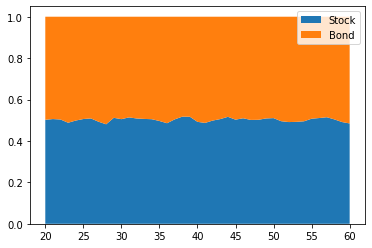


======episode 10 ======
Total Reward 2.9332261085510254
Total Return 24.339515686035156
Volatility 0.009957659989595413
Sharpe Ratio 8.737922668457031


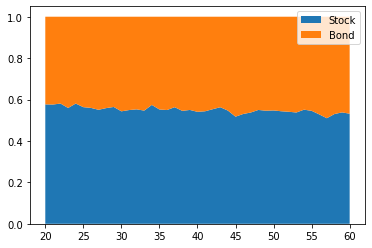


======episode 20 ======
Total Reward 2.9615273475646973
Total Return 26.079423904418945
Volatility 0.01204006839543581
Sharpe Ratio 7.466669082641602


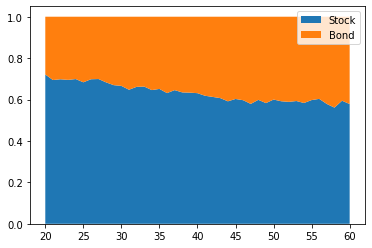


======episode 30 ======
Total Reward 3.023026943206787
Total Return 28.80514907836914
Volatility 0.014082994312047958
Sharpe Ratio 6.64265775680542


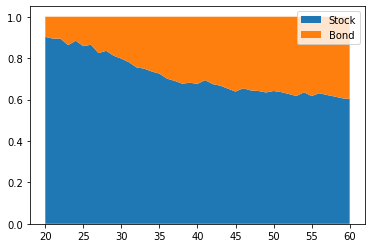


======episode 40 ======
Total Reward 3.0879974365234375
Total Return 29.827608108520508
Volatility 0.01329075451940298
Sharpe Ratio 7.071888446807861


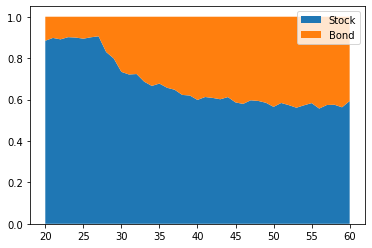


======episode 50 ======
Total Reward 3.119692802429199
Total Return 30.13876724243164
Volatility 0.011825586669147015
Sharpe Ratio 7.896419525146484


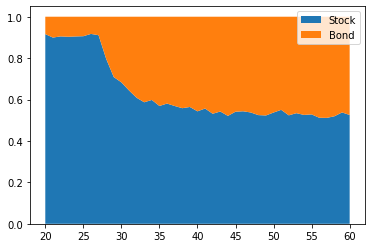


======Final Episode======
Total Reward 3.120950937271118
Total Return 29.57564353942871
Volatility 0.011222075670957565
Sharpe Ratio 8.250062942504883


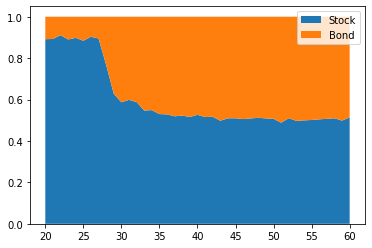

In [ ]:
#from re import I
rewardRec = []

for epoch in range(55 + 1):
  
  totalR = 0
  actionsRec = []
  TReturn = 1
  returnRec = []

  with tf.GradientTape() as tape:
    for i in range(Duration-1):
      # Add "Age" column
      dfSplit[Duration-i-1]['Age'] = age+i
      dfSplit[Duration-i-2]['Age'] = age+i+1


      # Set the input data of NN and the input data of Reward function
      dfModel = dfSplit[Duration-i-1][['StockRet', 'BondRet', 'Age']]
      dfApply = dfSplit[Duration-i-2][['StockRet', 'BondRet']]

      # Transform data
      arySplitM = dfModel.to_numpy().reshape(1, input_shape, 3)
      arySplitA = dfApply.to_numpy().reshape(1, input_shape, 2)

      stateM = tf.constant(arySplitM,dtype=np.float32)
      stateA = tf.constant(arySplitA,dtype=np.float32)
   
      # Obtain action weights from network
      action_weights = actor_network(stateM)

      # Set max and min value
      action_weights = tf.clip_by_value(action_weights, clip_value_min=0.1, clip_value_max=0.9)

      # Add random
      rand = tf.random.normal([1], 0, 0.01, tf.float32)
      action_weights = tf.add(action_weights, [rand[0], -rand[0]])
      
      # Set action
      action = action_weights
      actionsRec.append(action.numpy().flatten())
        
      # Obtain reward
      reward, risk, ret = get_reward(stateA, action, age+i)
      TReturn *= (1+ret)
      totalR += reward
      returnRec.append(ret.numpy())


    # Compute gradients
    grads = tape.gradient(-totalR, actor_network.trainable_variables)

    #Apply gradients to update network weights
    opt.apply_gradients(zip(grads, actor_network.trainable_variables))
  
  # Animation
  if np.mod(epoch, 10) == 0:       
    print('\n======episode',epoch, '======')
    # print('action', action)
    print('Total Reward', float(totalR))
    print('Total Return', float(TReturn-1))
    print('Volatility',float(np.var(returnRec)))
    print('Sharpe Ratio',float(np.mean(returnRec)/np.var(returnRec)))
    
    multiPlot(actionsRec) 
  
  
  rewardRec.append(totalR)


print('\n======Final Episode======')
print('Total Reward', float(totalR))
print('Total Return', float(TReturn-1))
print('Volatility',float(np.var(returnRec)))
print('Sharpe Ratio',float(np.mean(returnRec)/np.var(returnRec)))
multiPlot(actionsRec)

In [ ]:
len(returnRec)

41

## Monte Carlo Simulation

### Monte Carlo

In [ ]:
Duration = 41

### return vector  ###

return_vec = np.array([np.mean(equity_ret), np.mean(bond_ret)])
return_vec 

array([0.00042332, 0.00027226])

In [ ]:
### covariance matrix ###

return_cov = np.cov(equity_ret.to_numpy()[:-1], bond_ret.to_numpy()[:-1])
return_cov

array([[1.26568181e-04, 1.11932478e-06],
       [1.11932478e-06, 1.08064613e-05]])

In [ ]:
def get_MCList():
  ### simulate the monthly returns of bond and equity ###

  # amount of data required
  N = input_shape*Duration

  lower_triangular = np.linalg.cholesky(return_cov)
  standard_normal_matrix =  np.random.normal(0, 1, size=(2, N))
  return_stream = np.matmul(lower_triangular, standard_normal_matrix) + return_vec[:, np.newaxis]

  # prepare the list of dataframes for NN
  pdMCList = []
  for i in range(Duration):
    d = {'StockRet': return_stream[0][i*248: i*248+(input_shape)], 'BondRet': return_stream[1][i*248: i*248+(input_shape)]}
    pdMC = pd.DataFrame(data=d)
    pdMCList.append(pdMC)
  
  return pdMCList

### TDF Simulation

In [ ]:
from pandas._libs.tslibs.nattype import NaTType

# Define Risk Adjusted Returns
def sharpe_ratio(return_series, N=250, rf=0.01):
    mean = return_series.mean() - rf
    sigma = return_series.std()
    return mean / sigma

def sortino_ratio(series, N=250, rf=0.01):
    mean = series.mean() - rf
    std_neg = series[series<0].std()
    return mean/std_neg

def max_drawdown(return_series):
    comp_ret = (return_series+1).cumprod()
    peak = comp_ret.expanding(min_periods=1).max()
    dd = (comp_ret/peak)-1
    return dd.min()

def calmar_ratio(return_series, max_drawdowns, N=250):
    calmars = return_series.mean()/abs(max_drawdowns)
    return calmars

In [ ]:
# if RL = True, use RL algorithm for MC simulaiton; if False, use Vanguard glide path

def getMCResult(RL=True, Vanguard=None):
  pdMCList = get_MCList()

  totalR = 0
  actionsRec = []
  TReturn = 1
  returnRec = []

  for i in range(Duration-1):
    # Add "Age" column
    pdMCList[Duration-i-1]['Age'] = age+i
    pdMCList[Duration-i-2]['Age'] = age+i+1


    # Set the input data of NN and the input data of Reward function
    dfModel = pdMCList[Duration-i-1][['StockRet', 'BondRet', 'Age']]
    dfApply = pdMCList[Duration-i-2][['StockRet', 'BondRet']]

    # Transform data
    arySplitM = dfModel.to_numpy().reshape(1, input_shape, 3)
    arySplitA = dfApply.to_numpy().reshape(1, input_shape, 2)

    stateM = tf.constant(arySplitM,dtype=np.float32)
    stateA = tf.constant(arySplitA,dtype=np.float32)
   
    # Obtain action weights from network
    action_weights = actor_network(stateM)

    # Set max and min value
    action_weights = tf.clip_by_value(action_weights, clip_value_min=0.1, clip_value_max=0.9)

    # Add random
    rand = tf.random.normal([1], 0, 0.01, tf.float32)
    action_weights = tf.add(action_weights, [rand[0], -rand[0]])
      
    # Set action
    
    if RL:
      action = action_weights
      actionsRec.append(action.numpy().flatten())
    else:
      action = Vanguard[i]
      actionsRec.append(action.numpy().flatten())
        
    # Obtain reward
    reward, risk, ret = get_reward(stateA, action, age+i)
    TReturn *= (1+ret)
    totalR += reward
    returnRec.append(ret.numpy())

  # calculate ratios
  x = pd.Series(returnRec)
  # print(x)

  sharpe = sharpe_ratio(x, Duration)
  sortino = sortino_ratio(x, Duration)
  drawdown = max_drawdown(x)
  calmar = calmar_ratio(x, drawdown, Duration)

  return returnRec, sharpe, sortino, drawdown, calmar, actionsRec, float(TReturn-1)

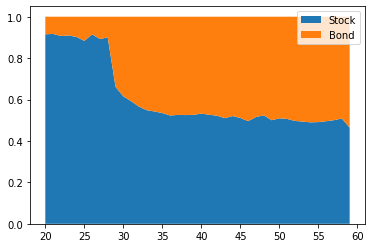

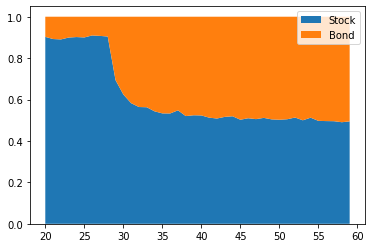

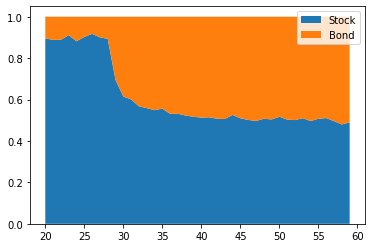

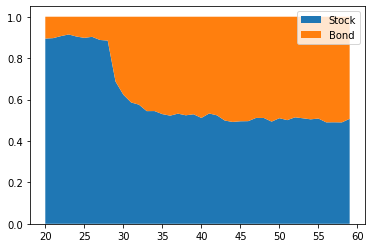

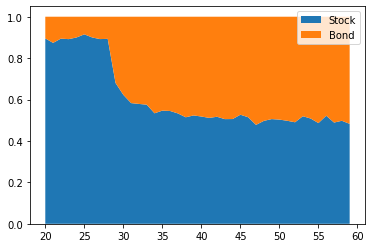

...

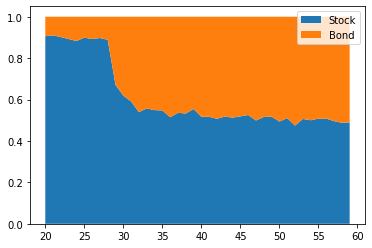

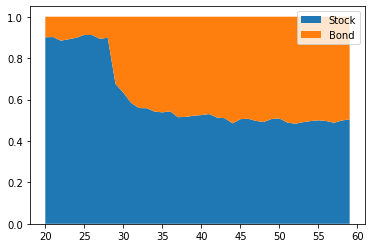

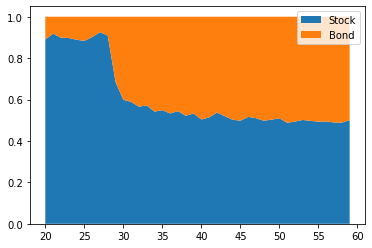

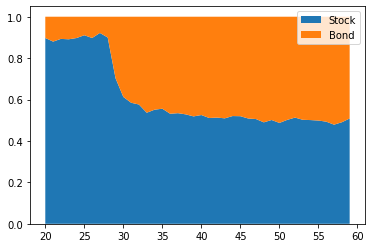

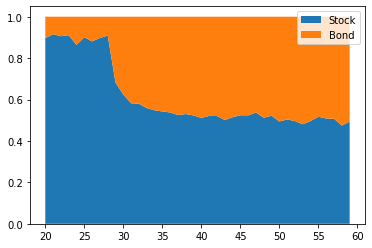

In [ ]:
# Calculate ratios for every MC simulations and record it

returnList = []
sharpeList = []
sortinoList = []
drawdownList = []
calmarList = []
cumReturnList = []

for i in range(1000):
  totalR, sharpe, sortino, drawdown, calmar, actionsRec, cumReturn = getMCResult(RL=True)
  returnList.append(totalR)
  cumReturnList.append(cumReturn)
  sharpeList.append(sharpe)
  sortinoList.append(sortino)
  drawdownList.append(drawdown)
  calmarList.append(calmar)
  multiPlot(actionsRec)

In [ ]:
# Create Vanguard Glide Path

y25 = np.linspace(start=0.9, stop=0.9, num=15)
y40 = np.linspace(start=0.9, stop=0.5, num=26)
vanguard = np.append(y25, y40)

vanguardList = []
for i in range(Duration):
  v = tf.constant([[vanguard[i], 1-vanguard[i]]], dtype=tf.float32)
  vanguardList.append(v)

In [ ]:
# Create Vanguard Glide Path

y25 = np.linspace(start=1, stop=1, num=15)
y40 = np.linspace(start=1, stop=0.6, num=26)
vanguard = np.append(y25, y40)

vanguardListA = []
for i in range(Duration):
  v = tf.constant([[vanguard[i], 1-vanguard[i]]], dtype=tf.float32)
  vanguardListA.append(v)

In [ ]:
# Create Vanguard Glide Path

y25 = np.linspace(start=0.8, stop=0.8, num=15)
y40 = np.linspace(start=0.8, stop=0.4, num=26)
vanguard = np.append(y25, y40)

vanguardListP = []
for i in range(Duration):
  v = tf.constant([[vanguard[i], 1-vanguard[i]]], dtype=tf.float32)
  vanguardListP.append(v)

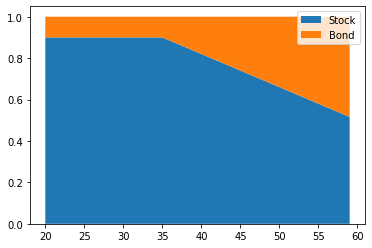

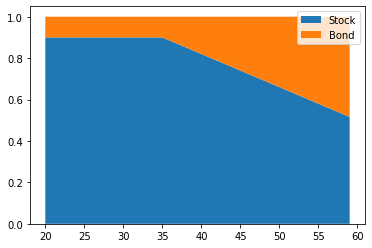

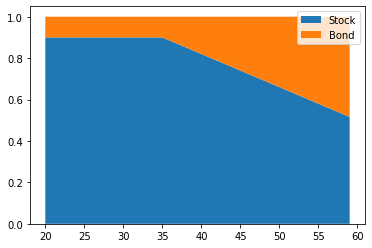

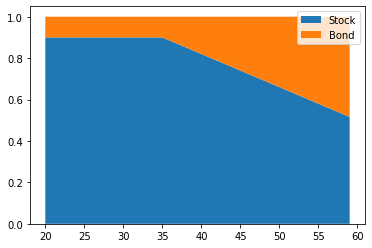

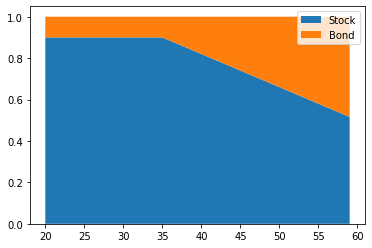

...

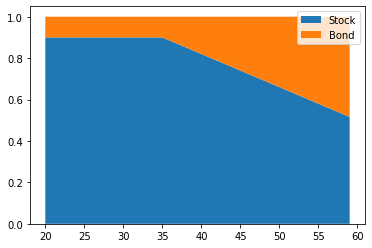

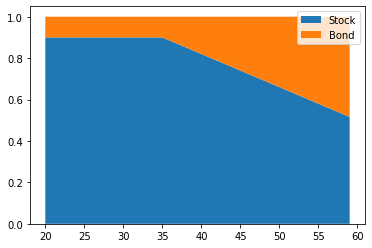

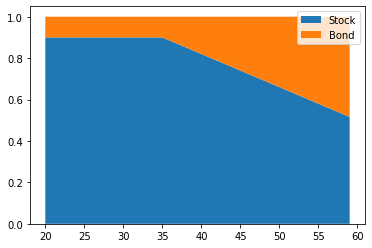

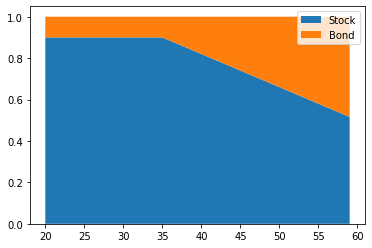

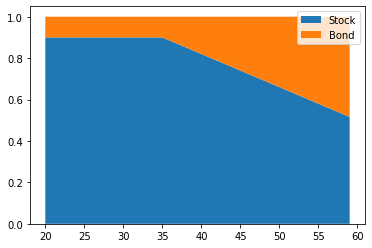

In [ ]:
# Calculate ratios for every MC simulations and record it for Vanguard

returnListV = []
sharpeListV = []
sortinoListV = []
drawdownListV = []
calmarListV = []
cumReturnListV = []

for i in range(1000):
  totalR, sharpe, sortino, drawdown, calmar, actionsRec, cumReturn = getMCResult(RL=False, Vanguard=vanguardList)
  returnListV.append(totalR)
  cumReturnListV.append(cumReturn)
  sharpeListV.append(sharpe)
  sortinoListV.append(sortino)
  drawdownListV.append(drawdown)
  calmarListV.append(calmar)
  multiPlot(actionsRec)

### Simulation Result

[0.5935725967670245, 0.6853537699485173]

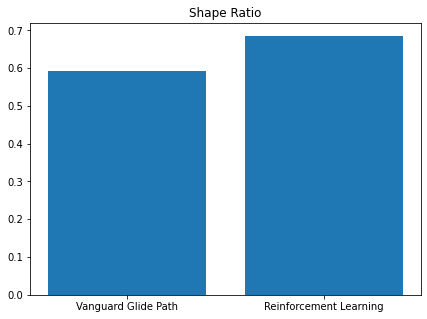

In [ ]:
import statistics as stat

test = [stat.mean(sharpeListV), stat.mean(sharpeList)]
plt.figure(figsize=(7,5))
plt.title('Shape Ratio')
plt.bar(['Vanguard Glide Path', 'Reinforcement Learning'], test)
test

[0.5935725967670245, 0.6853537699485173]

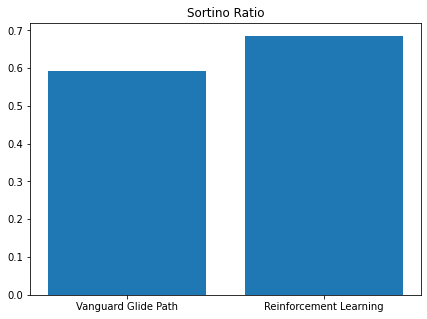

In [ ]:
sortinoList = [x for x in sortinoList if str(x) != 'nan']
test1 = [stat.mean(sortinoListV), stat.mean(sortinoList)]
plt.figure(figsize=(7,5))
plt.title('Sortino Ratio')
plt.bar(['Vanguard Glide Path', 'Reinforcement Learning'], test)
test

[-0.26755286854278854, -0.19083711038639858]

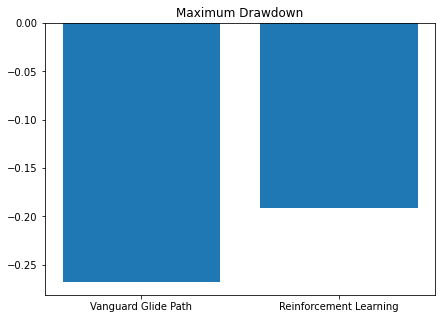

In [ ]:
test = [stat.mean(drawdownListV), stat.mean(drawdownList)]
plt.figure(figsize=(7,5))
plt.title('Maximum Drawdown')
plt.bar(['Vanguard Glide Path', 'Reinforcement Learning'], test)
test

[0.46241374368790844, 0.6395548644089892]

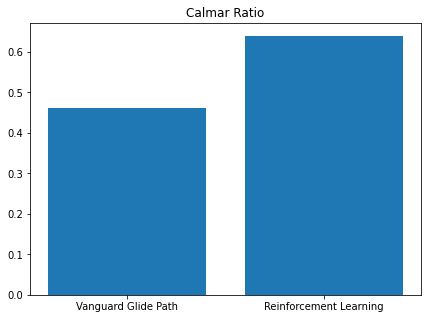

In [ ]:
test = [stat.mean(calmarListV), stat.mean(calmarList)]
plt.figure(figsize=(7,5))
plt.title('Calmar Ratio')
plt.bar(['Vanguard Glide Path', 'Reinforcement Learning'], test)
test

[0.10156339, 0.09476324]

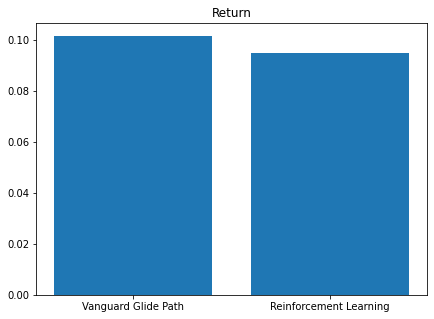

In [ ]:
test = [stat.mean(np.vstack(returnListV).flatten()), stat.mean(np.vstack(returnList).flatten())]
plt.figure(figsize=(7,5))
plt.title('Return')
plt.bar(['Vanguard Glide Path', 'Reinforcement Learning'], test)
test

[48.31582594513893, 36.74139637541771]

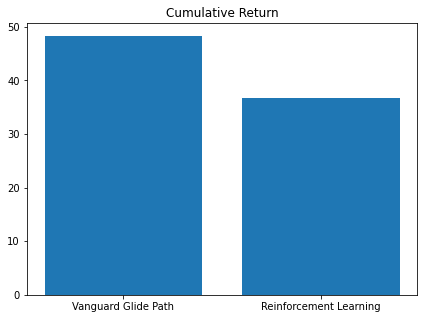

In [ ]:
test = [stat.mean(cumReturnListV), stat.mean(cumReturnList)]
plt.figure(figsize=(7,5))
plt.title('Cumulative Return')
plt.bar(['Vanguard Glide Path', 'Reinforcement Learning'], test)
test